# Detecção de objetos

Detectar um objeto envolve geralmente duas tarefas em conjunto:
- Onde está o objeto (localização)
- Que objeto é (classificação)

Diferente de segmentação, na detecção os objetos individuais são detectados. Portanto, é possível também fazer contagem com estes modelos.

## Modelo de detecção

Vamos testar com este modelo: https://huggingface.co/facebook/detr-resnet-50

Este modelo (e outros de detecção) dependem da biblioteca `timm`:

```bash
pip install timm
```

In [57]:
from transformers import pipeline

detector = pipeline("object-detection", model="facebook/detr-resnet-50")

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


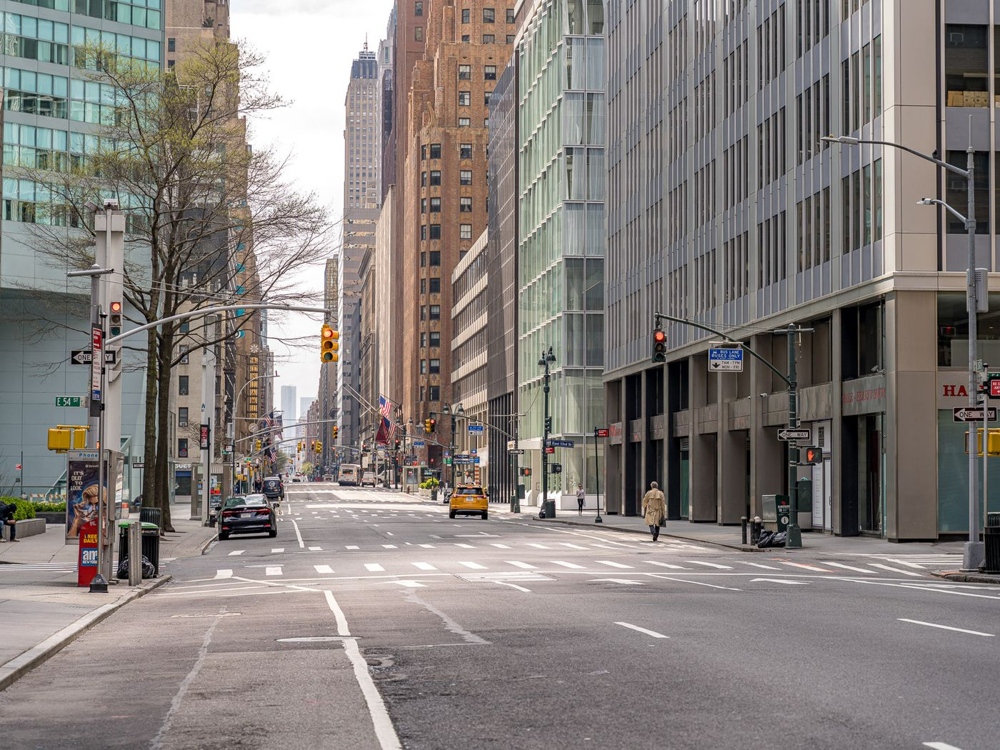

In [58]:
from pathlib import Path
from PIL import Image

imagem = Image.open(Path('imagens/cidades/city.jpg'))
imagem

In [59]:
deteccao = detector(imagem)
deteccao

[{'score': 0.9898137450218201,
  'label': 'traffic light',
  'box': {'xmin': 450, 'ymin': 459, 'xmax': 472, 'ymax': 511}},
 {'score': 0.9131624698638916,
  'label': 'traffic light',
  'box': {'xmin': 411, 'ymin': 617, 'xmax': 424, 'ymax': 635}},
 {'score': 0.9877977967262268,
  'label': 'traffic light',
  'box': {'xmin': 147, 'ymin': 422, 'xmax': 168, 'ymax': 466}},
 {'score': 0.9033779501914978,
  'label': 'person',
  'box': {'xmin': 0, 'ymin': 700, 'xmax': 23, 'ymax': 757}},
 {'score': 0.9550831317901611,
  'label': 'traffic light',
  'box': {'xmin': 1129, 'ymin': 627, 'xmax': 1152, 'ymax': 649}},
 {'score': 0.9579179286956787,
  'label': 'traffic light',
  'box': {'xmin': 466, 'ymin': 595, 'xmax': 477, 'ymax': 617}},
 {'score': 0.9865922331809998,
  'label': 'traffic light',
  'box': {'xmin': 594, 'ymin': 583, 'xmax': 609, 'ymax': 610}},
 {'score': 0.944581925868988,
  'label': 'traffic light',
  'box': {'xmin': 60, 'ymin': 597, 'xmax': 124, 'ymax': 632}},
 {'score': 0.9366470575332

O resultado é uma lista de dicionários, onde cada dicionário possui:
- label: qual é o objeto
- box: onde está o objeto
- score: qual a certeza da detecção

Vamos plotar um objeto para vê-lo na imagem:

In [60]:
det = deteccao[0]
det

{'score': 0.9898137450218201,
 'label': 'traffic light',
 'box': {'xmin': 450, 'ymin': 459, 'xmax': 472, 'ymax': 511}}

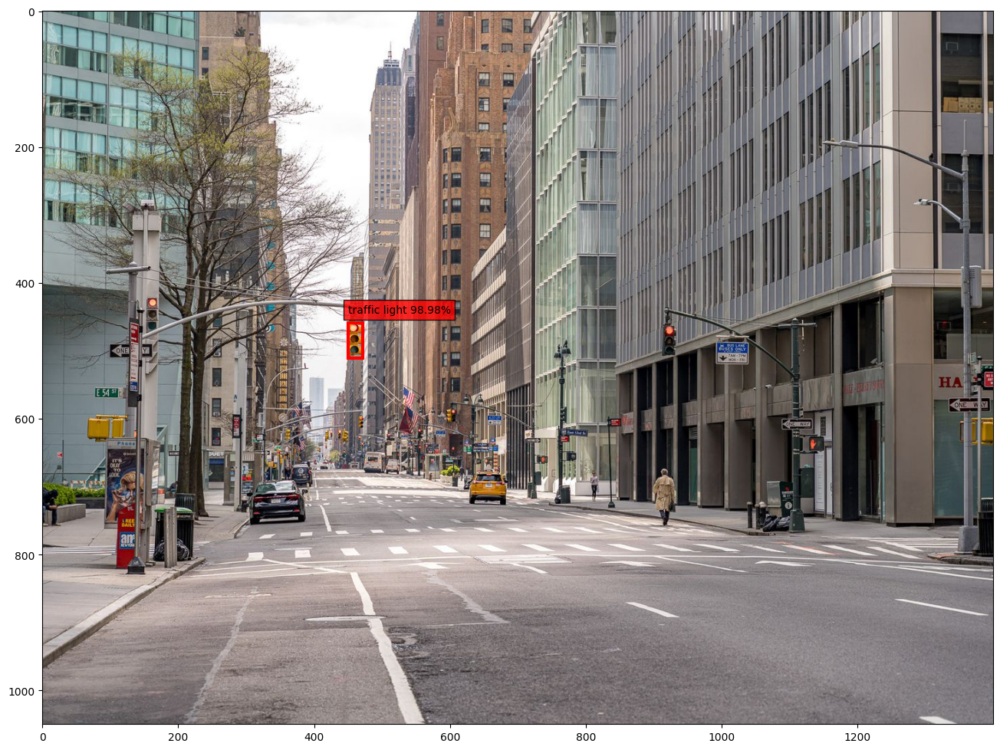

In [61]:
import matplotlib.pyplot as plt
from matplotlib import patches

fig, ax = plt.subplots(figsize=(16, 16))
ax.imshow(imagem)

box = det['box']
origem = (box['xmin'], box['ymin'])
largura = box['xmax'] - box['xmin']
altura = box['ymax'] - box['ymin']

rect = patches.Rectangle(origem, largura, altura, linewidth=3, edgecolor='red', facecolor='none')
ax.add_patch(rect)

texto = f"{det['label']} {100 * det['score']:.2f}%"
ax.text(box['xmin'], box['ymin'] - 15, texto, bbox={'facecolor': 'red', 'alpha': 0.8})

plt.show()

Parece ter funcionado! Vamos agora plotar todos os labels detectados:

In [62]:
def plotar_deteccao(imagem, deteccao):
    fig, ax = plt.subplots(figsize=(16, 16))
    ax.imshow(imagem)
    
    for det in deteccao:
        box = det['box']
        origem = (box['xmin'], box['ymin'])
        largura = box['xmax'] - box['xmin']
        altura = box['ymax'] - box['ymin']
        
        rect = patches.Rectangle(origem, largura, altura, linewidth=3, edgecolor='red', facecolor='none')
        ax.add_patch(rect)
        
        texto = f"{det['label']} {100 * det['score']:.2f}%"
        ax.text(box['xmin'], box['ymin'] - 15, texto, bbox={'facecolor': 'red', 'alpha': 0.8})

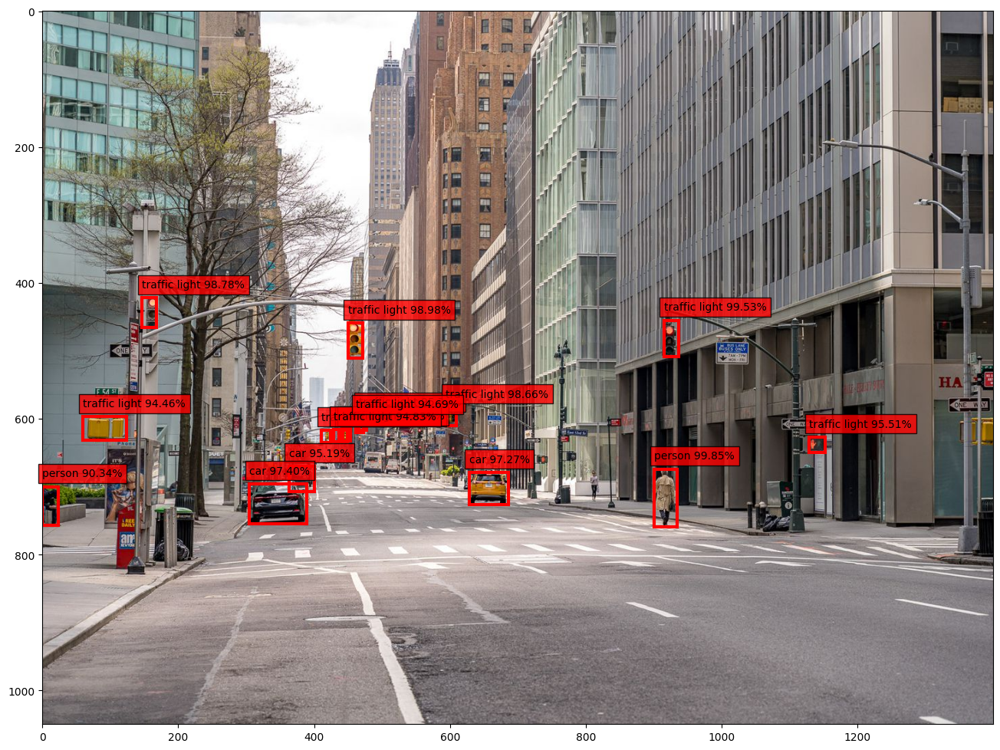

In [63]:
plotar_deteccao(imagem=imagem, deteccao=deteccao)
plt.show()

Por padrão, o modelo parece ignorar detecções abaixo de 90% de certeza:

In [64]:
len(deteccao)

17

In [65]:
min(det['score'] for det in deteccao)

0.9033779501914978

Mas podemos ajustar isso com o argumento `threshold`, sob o risco de retornar detecções erradas:

In [66]:
deteccao = detector(imagem, threshold=0.5)
deteccao

[{'score': 0.8660397529602051,
  'label': 'traffic light',
  'box': {'xmin': 548, 'ymin': 620, 'xmax': 564, 'ymax': 641}},
 {'score': 0.9898137450218201,
  'label': 'traffic light',
  'box': {'xmin': 450, 'ymin': 459, 'xmax': 472, 'ymax': 511}},
 {'score': 0.8340936899185181,
  'label': 'traffic light',
  'box': {'xmin': 540, 'ymin': 625, 'xmax': 556, 'ymax': 646}},
 {'score': 0.673572301864624,
  'label': 'car',
  'box': {'xmin': 375, 'ymin': 664, 'xmax': 404, 'ymax': 685}},
 {'score': 0.9131624698638916,
  'label': 'traffic light',
  'box': {'xmin': 411, 'ymin': 617, 'xmax': 424, 'ymax': 635}},
 {'score': 0.8542624711990356,
  'label': 'person',
  'box': {'xmin': 807, 'ymin': 677, 'xmax': 822, 'ymax': 719}},
 {'score': 0.6365007162094116,
  'label': 'person',
  'box': {'xmin': 592, 'ymin': 669, 'xmax': 609, 'ymax': 699}},
 {'score': 0.9877977967262268,
  'label': 'traffic light',
  'box': {'xmin': 147, 'ymin': 422, 'xmax': 168, 'ymax': 466}},
 {'score': 0.6702432632446289,
  'label':

In [67]:
len(deteccao)

46

In [68]:
min(det['score'] for det in deteccao)

0.5578702688217163

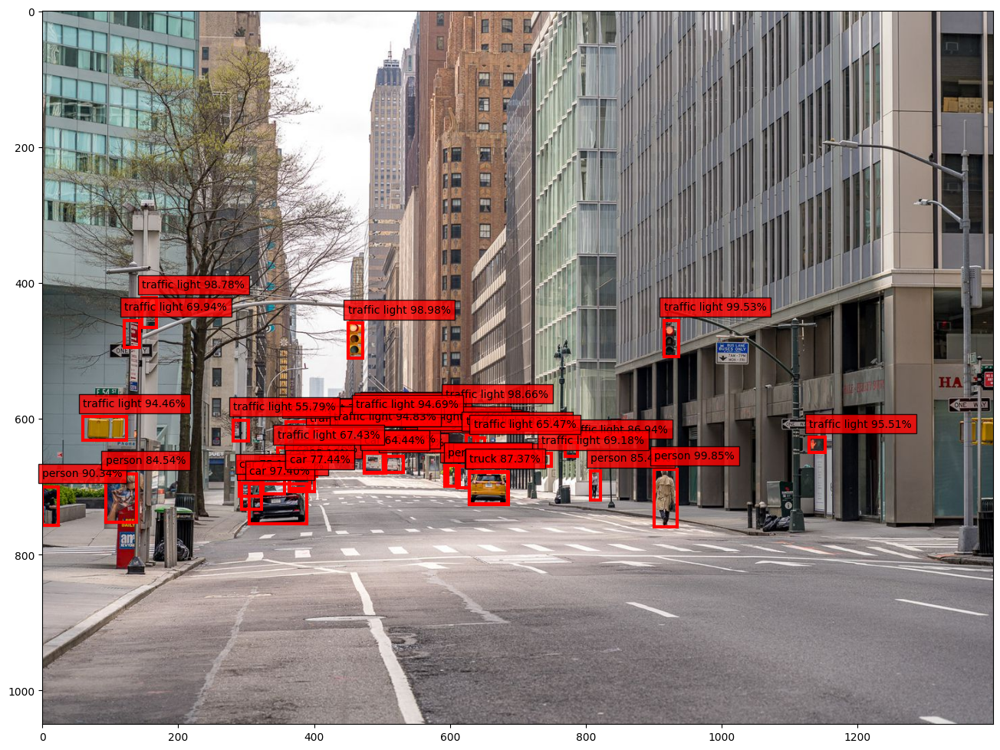

In [69]:
plotar_deteccao(imagem=imagem, deteccao=deteccao)
plt.show()

In [70]:
deteccao = detector(imagem, threshold=0.1)
deteccao

[{'score': 0.2587820589542389,
  'label': 'person',
  'box': {'xmin': 107, 'ymin': 684, 'xmax': 141, 'ymax': 729}},
 {'score': 0.8660397529602051,
  'label': 'traffic light',
  'box': {'xmin': 548, 'ymin': 620, 'xmax': 564, 'ymax': 641}},
 {'score': 0.4290975332260132,
  'label': 'truck',
  'box': {'xmin': 307, 'ymin': 691, 'xmax': 384, 'ymax': 741}},
 {'score': 0.49157896637916565,
  'label': 'traffic light',
  'box': {'xmin': 593, 'ymin': 583, 'xmax': 608, 'ymax': 609}},
 {'score': 0.9898137450218201,
  'label': 'traffic light',
  'box': {'xmin': 450, 'ymin': 459, 'xmax': 472, 'ymax': 511}},
 {'score': 0.43020936846733093,
  'label': 'car',
  'box': {'xmin': 512, 'ymin': 654, 'xmax': 540, 'ymax': 679}},
 {'score': 0.8340936899185181,
  'label': 'traffic light',
  'box': {'xmin': 540, 'ymin': 625, 'xmax': 556, 'ymax': 646}},
 {'score': 0.673572301864624,
  'label': 'car',
  'box': {'xmin': 375, 'ymin': 664, 'xmax': 404, 'ymax': 685}},
 {'score': 0.9131624698638916,
  'label': 'traffic

In [71]:
len(deteccao)

94

In [72]:
min(det['score'] for det in deteccao)

0.10451134294271469

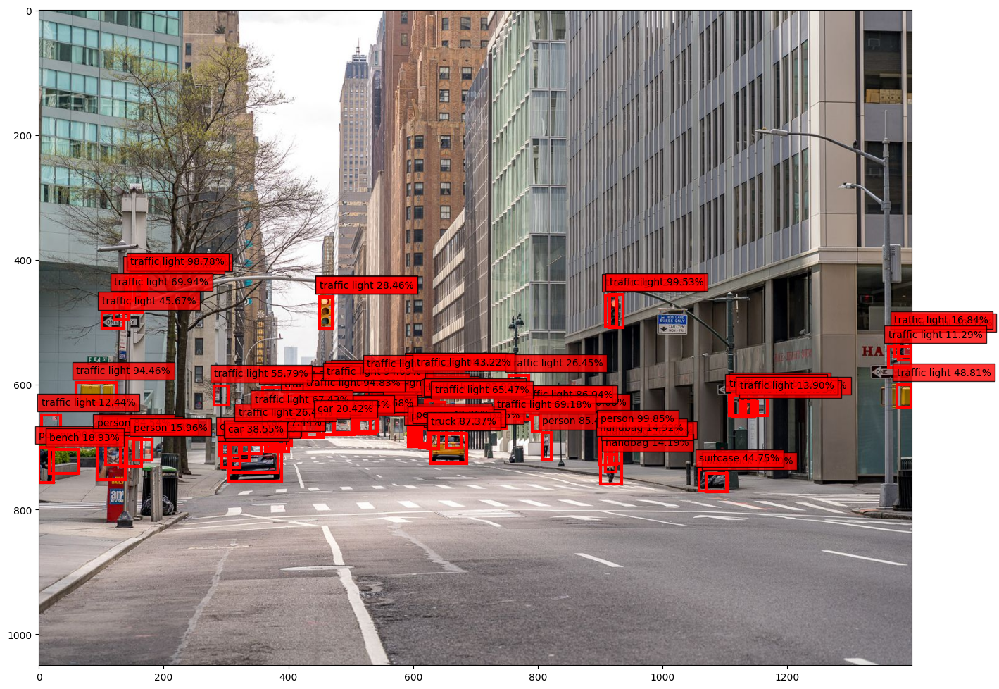

In [73]:
plotar_deteccao(imagem=imagem, deteccao=deteccao)
plt.show()

Com thresholds baixos, geralmente o modelo detecta o **objeto errado**, e pode detectar **o mesmo objeto mútliplas vezes**.

Mesmo assim, não existe um nível de threshold "seguro" ou "ideal", porque depende da tarefa. Por exemplo, se eu estiver treinando um modelo pra detectar câncer em imagem médica, é melhor ter falsos positivos (um "alarme falso"), do que não detectar uma potencial doença!

## De onde vieram as detecções?

Vimos também que o modelo não detecta todo tipo de objeto. Na realidade, segundo o [cartão do modelo](https://huggingface.co/facebook/detr-resnet-50), ele foi treinado com o conjunto de dados COCO: https://cocodataset.org

## Criando anotações coloridas

Vamos adaptar nossa função para que as anotações de cada classe possuam cores específicas:

In [87]:
from matplotlib import colormaps
import numpy as np

def plotar_deteccao(imagem, deteccao, colormap='viridis'):
    labels = {det['label'] for det in deteccao}
    indices_cor = np.linspace(0, 1, len(labels))
    cores = [colormaps.get_cmap(colormap)(x) for x in indices_cor]
    cores = dict(zip(labels, cores))
    
    fig, ax = plt.subplots(figsize=(12, 12))
    ax.imshow(imagem)
    
    for det in deteccao:
        box = det['box']
        cor = cores[det['label']]
        origem = (box['xmin'], box['ymin'])
        largura = box['xmax'] - box['xmin']
        altura = box['ymax'] - box['ymin']
        
        rect = patches.Rectangle(origem, largura, altura, linewidth=3, edgecolor=cor, facecolor='none')
        ax.add_patch(rect)

        texto = f"{det['label']} {100 * det['score']:.2f}%"
        ax.text(box['xmin'], box['ymin'] - 15, texto, bbox={'facecolor': cor, 'alpha': 0.8})

Counter({'traffic light': 12, 'car': 3, 'person': 2})


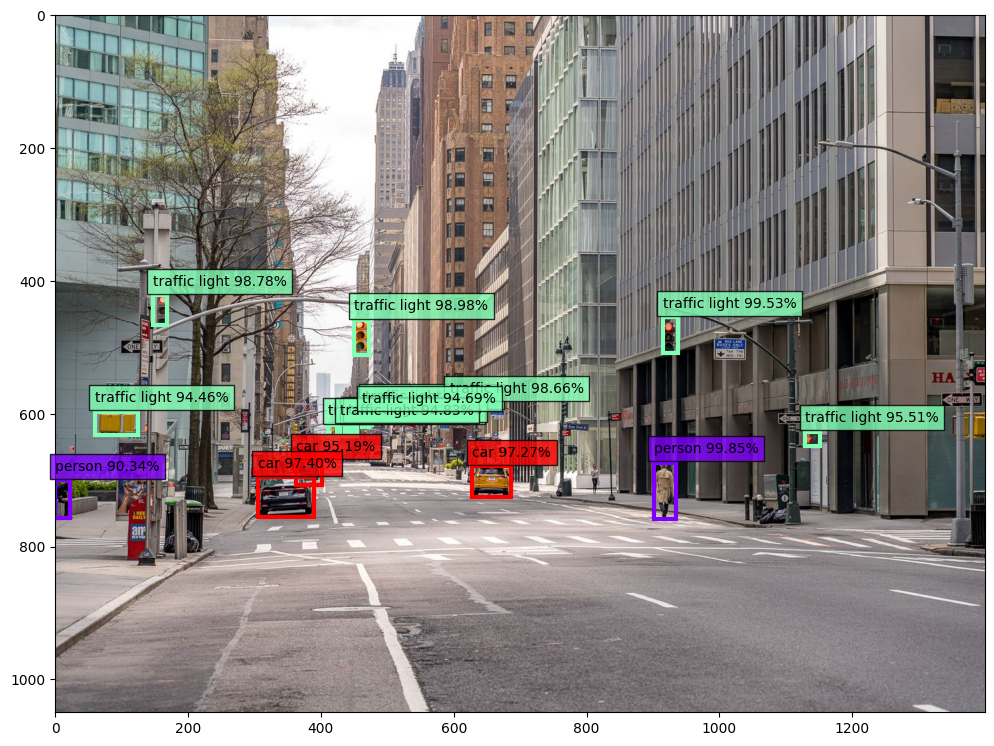

In [88]:
from collections import Counter

deteccao = detector(imagem, threshold=0.9)

contador = Counter(det['label'] for det in deteccao)
print(contador)

plotar_deteccao(imagem=imagem, deteccao=deteccao, colormap='rainbow')
plt.show()

## Testando em outras imagens

Counter({'vase': 3, 'chair': 2, 'potted plant': 2, 'couch': 1})


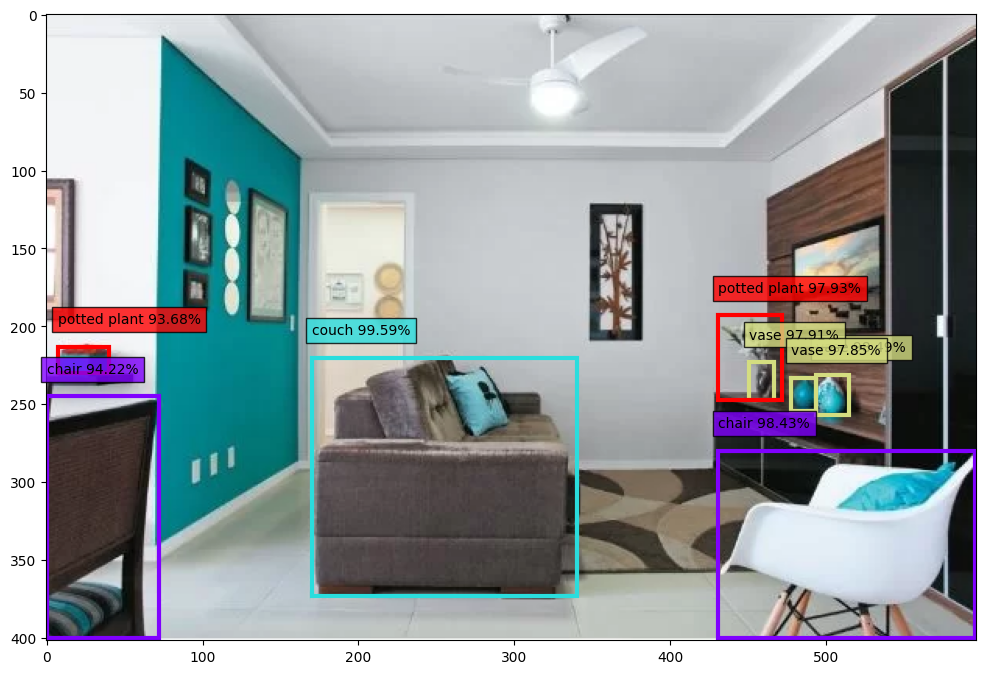

Counter({'book': 5, 'laptop': 1, 'chair': 1, 'potted plant': 1, 'cup': 1, 'couch': 1})


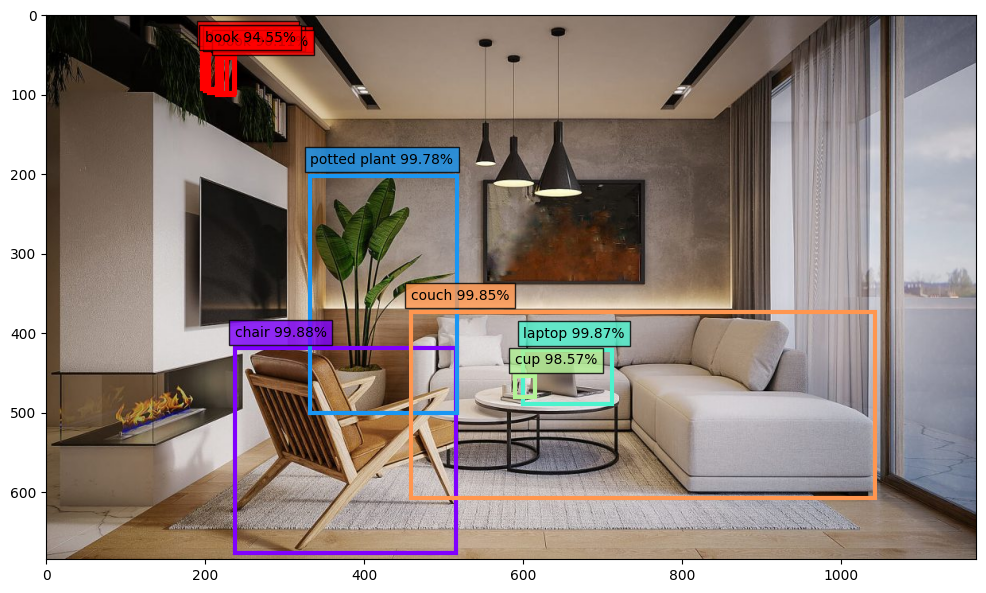

Counter({'potted plant': 2, 'sink': 1, 'toilet': 1})


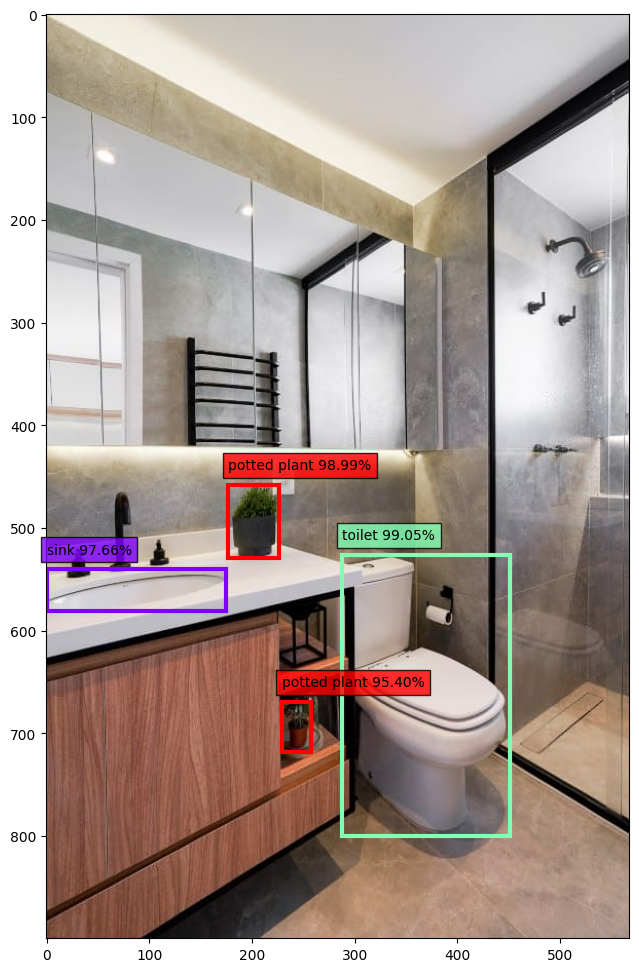

Counter({'person': 15, 'bicycle': 1, 'traffic light': 1, 'fire hydrant': 1})


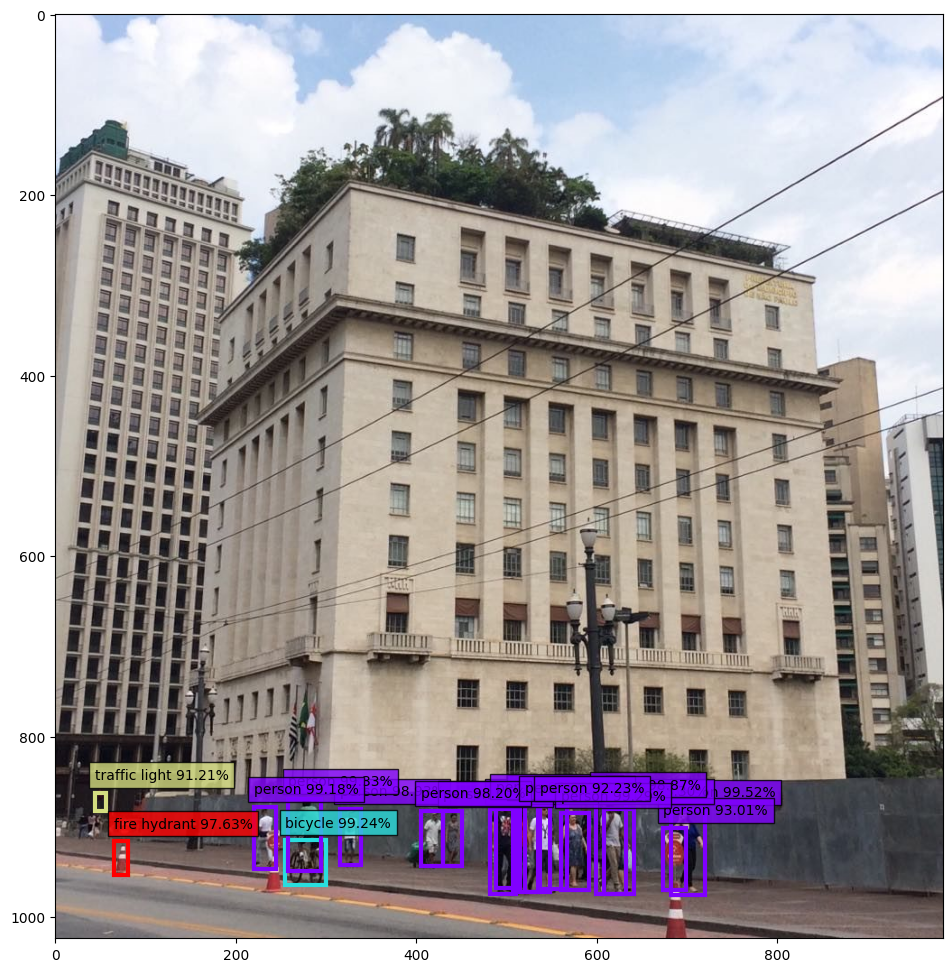

Counter({'person': 10})


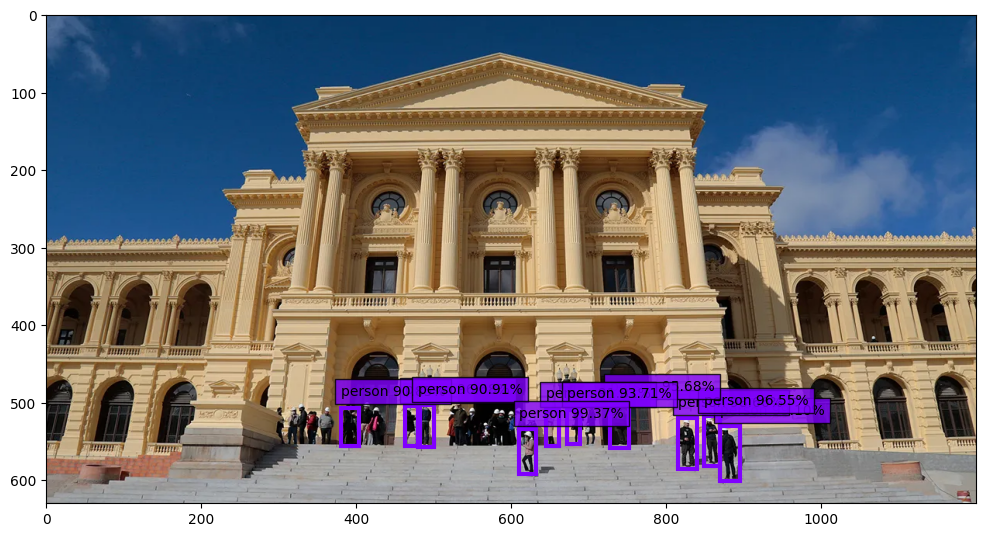

Counter({'person': 1, 'car': 1, 'handbag': 1})


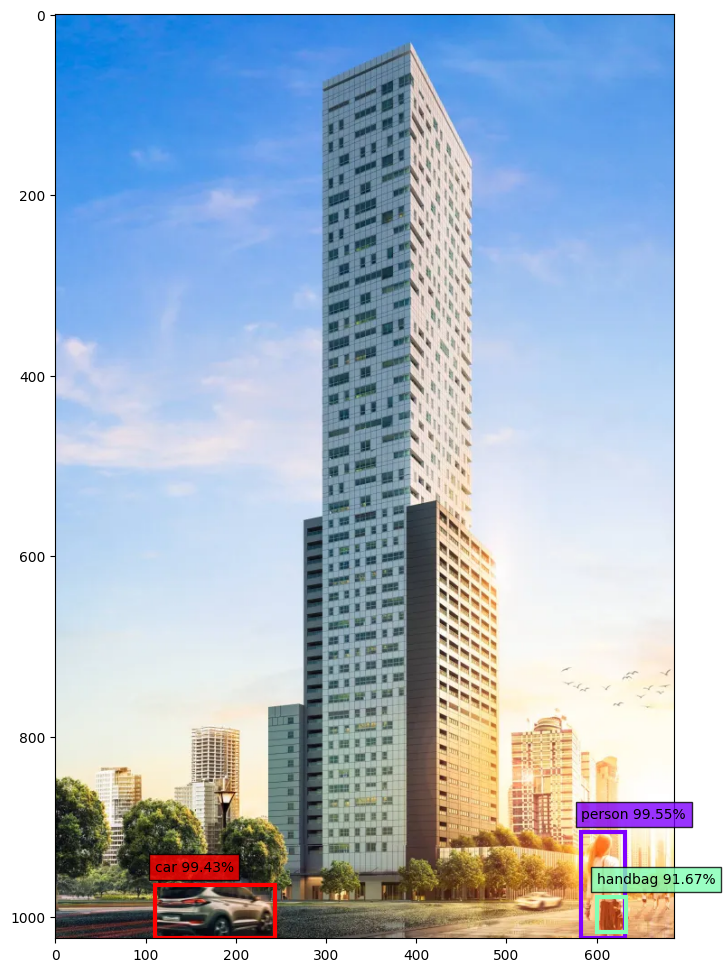

Counter({'chair': 2, 'sink': 1, 'vase': 1, 'refrigerator': 1, 'potted plant': 1})


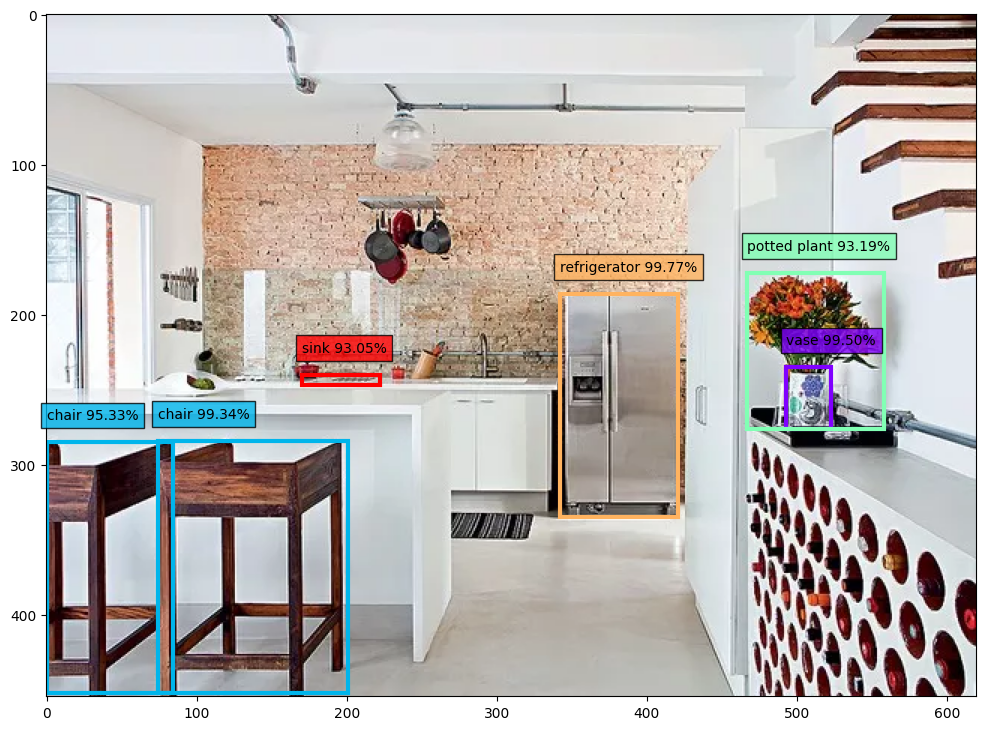

Counter()


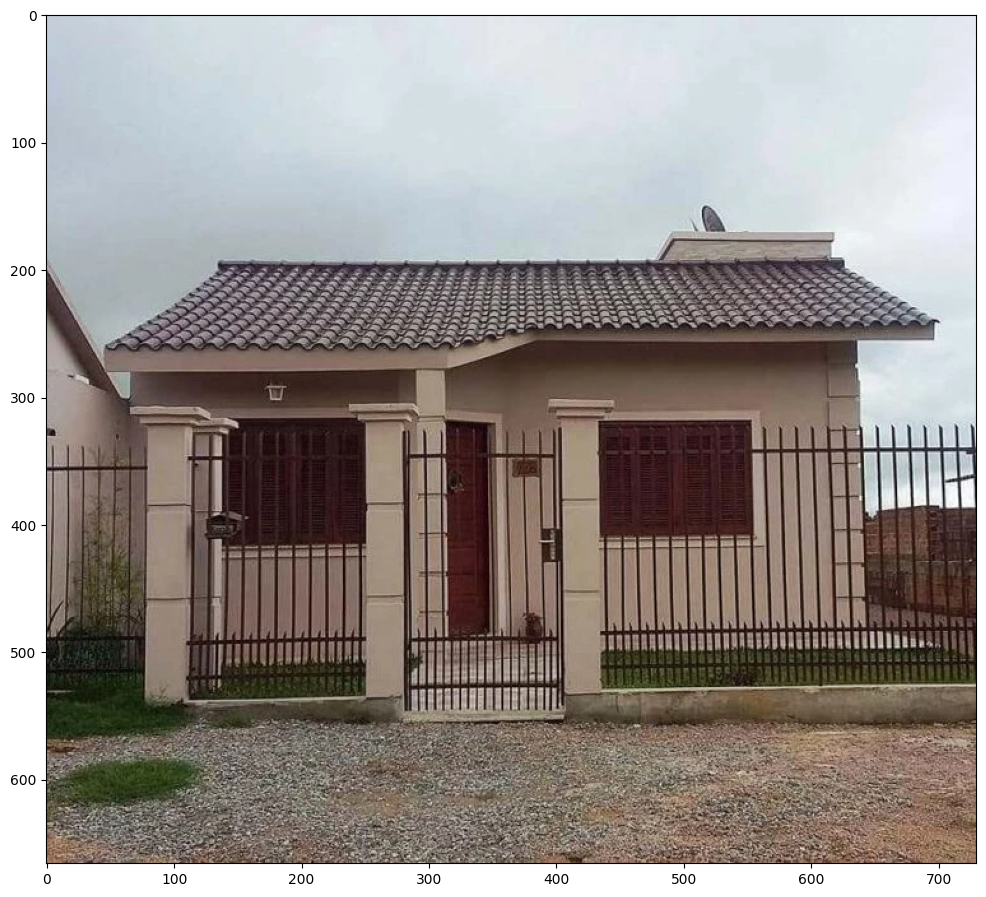

Counter({'potted plant': 3, 'couch': 2, 'dining table': 1, 'tv': 1, 'vase': 1})


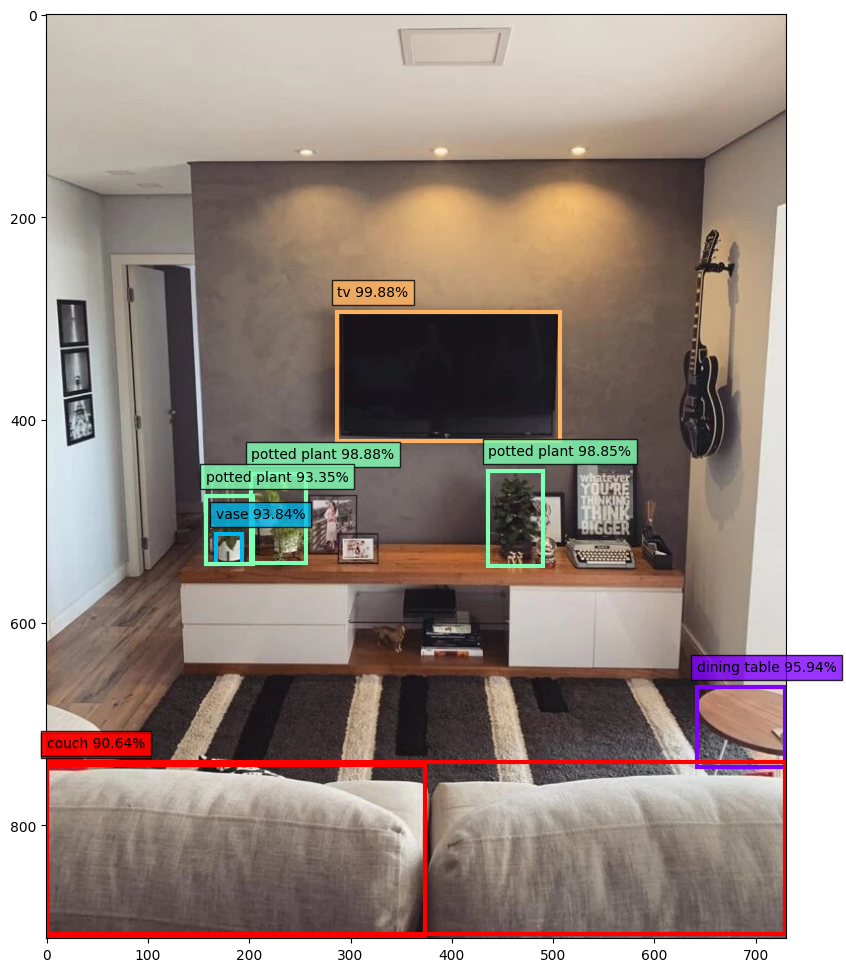

Counter({'potted plant': 2, 'couch': 2, 'bowl': 1, 'tv': 1, 'dining table': 1})


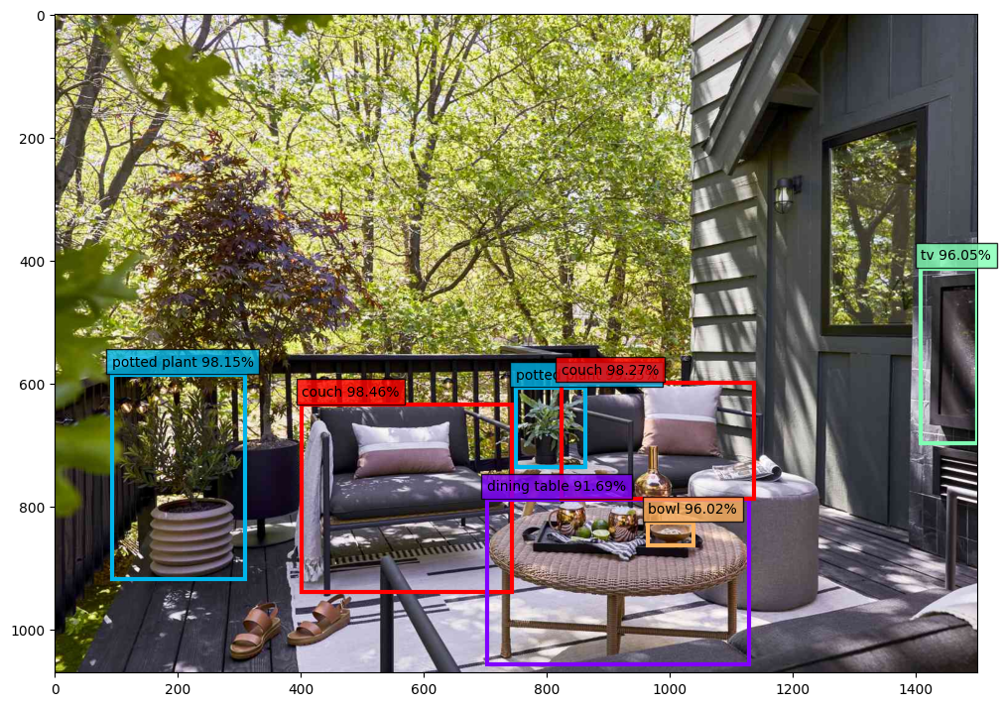

Counter({'sink': 2, 'bowl': 1, 'toilet': 1, 'bottle': 1})


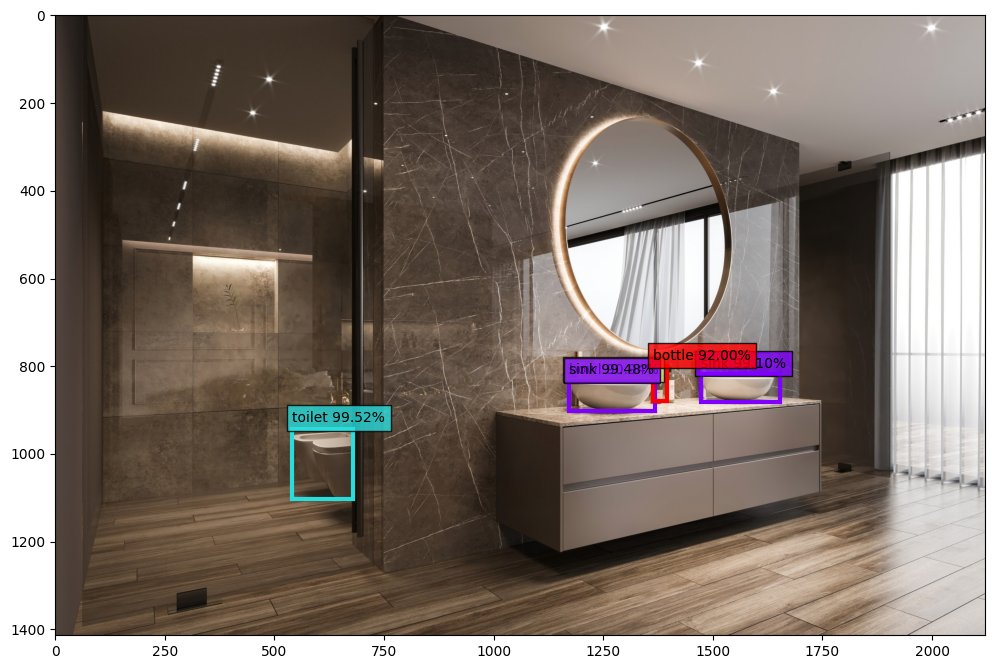

In [89]:
imagens = [Image.open(arquivo) for arquivo in Path('imagens/casas').iterdir()]

for imagem in imagens:    
    deteccao = detector(imagem)
    contador = Counter(det['label'] for det in deteccao)
    print(contador)
    plotar_deteccao(imagem=imagem, deteccao=deteccao, colormap='rainbow')
    plt.show()

## Outros modelos de detecção

Vamos agora passar para este modelo: https://huggingface.co/devonho/detr-resnet-50_finetuned_cppe5

Como o nome deixa claro, é o mesmo `detr-resnet-50` que utilizamos, porém ajustado para o seguinte conjunto de dados: https://huggingface.co/datasets/cppe-5

In [93]:
from datasets import load_dataset

dados = load_dataset('cppe-5', split='train')
dados

Dataset({
    features: ['image_id', 'image', 'width', 'height', 'objects'],
    num_rows: 1000
})

In [94]:
dados[0]

{'image_id': 15,
 'image': <PIL.JpegImagePlugin.JpegImageFile image mode=RGB size=943x663>,
 'width': 943,
 'height': 663,
 'objects': {'id': [114, 115, 116, 117],
  'area': [3796, 1596, 152768, 81002],
  'bbox': [[302.0, 109.0, 73.0, 52.0],
   [810.0, 100.0, 57.0, 28.0],
   [160.0, 31.0, 248.0, 616.0],
   [741.0, 68.0, 202.0, 401.0]],
  'category': [4, 4, 0, 0]}}

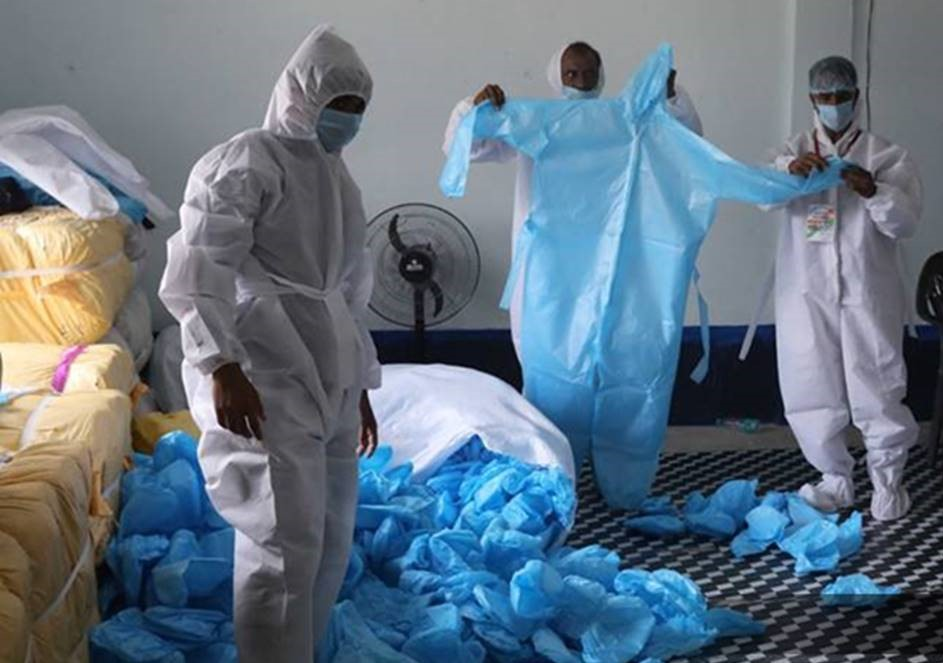

In [95]:
dados[0]['image']

In [96]:
modelo = 'devonho/detr-resnet-50_finetuned_cppe5'
detector = pipeline('object-detection', model=modelo)

config.json:   0%|          | 0.00/1.32k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/167M [00:00<?, ?B/s]

Some weights of the model checkpoint at devonho/detr-resnet-50_finetuned_cppe5 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


preprocessor_config.json:   0%|          | 0.00/401 [00:00<?, ?B/s]

Counter({'Gloves': 1, 'Mask': 1})


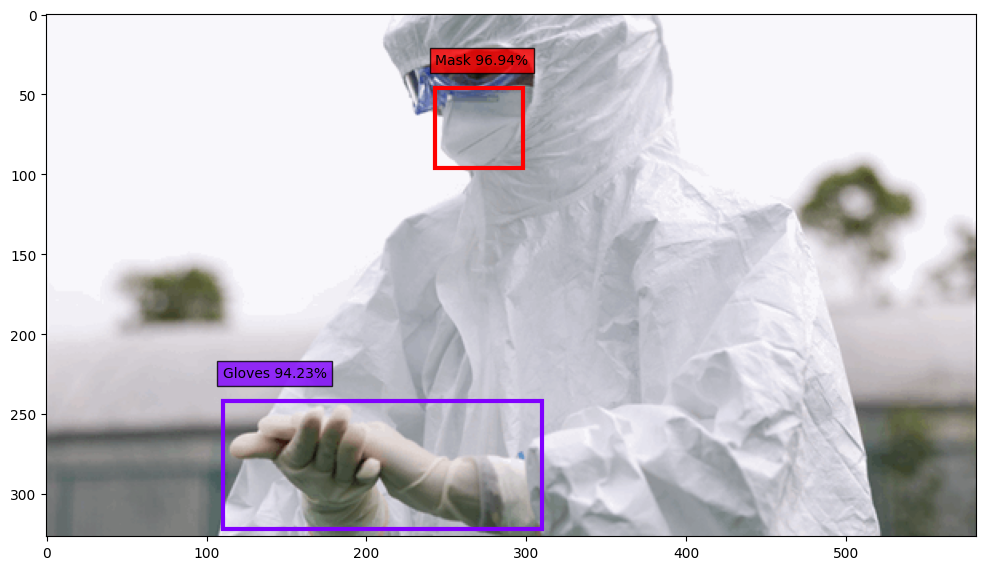

Counter()


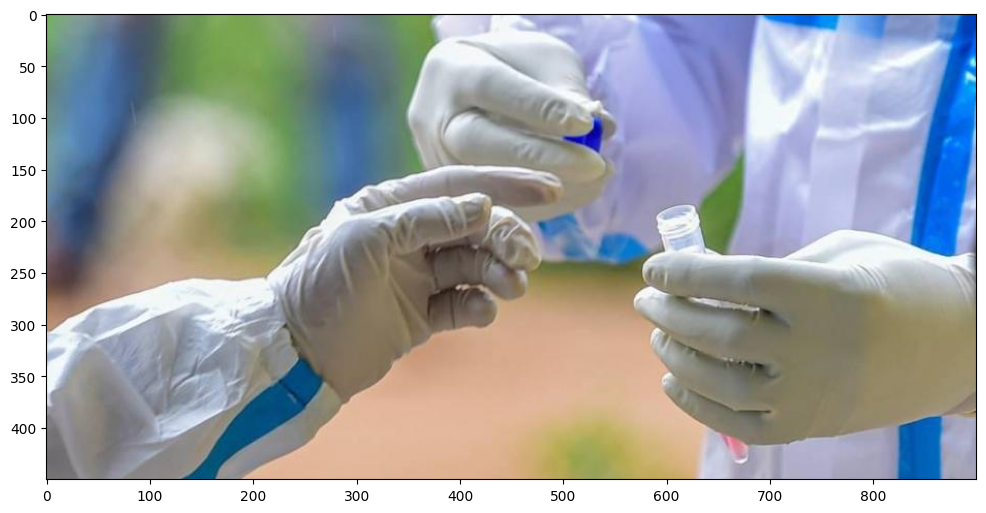

Counter({'Gloves': 1, 'Face_Shield': 1})


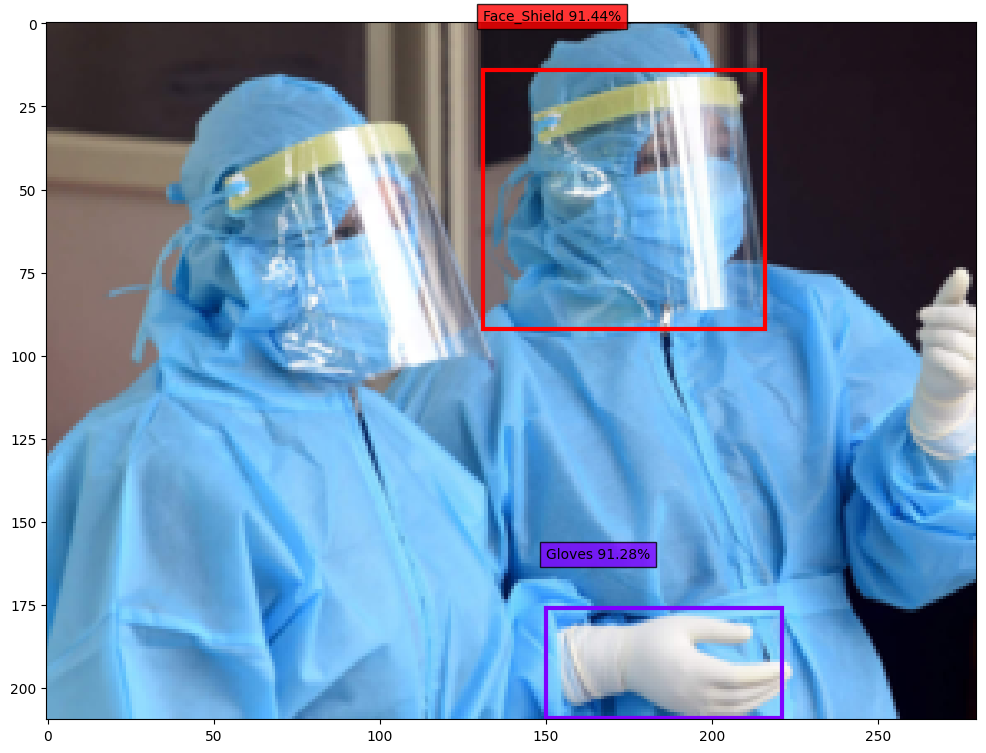

Counter({'Mask': 2, 'Gloves': 2, 'Coverall': 2})


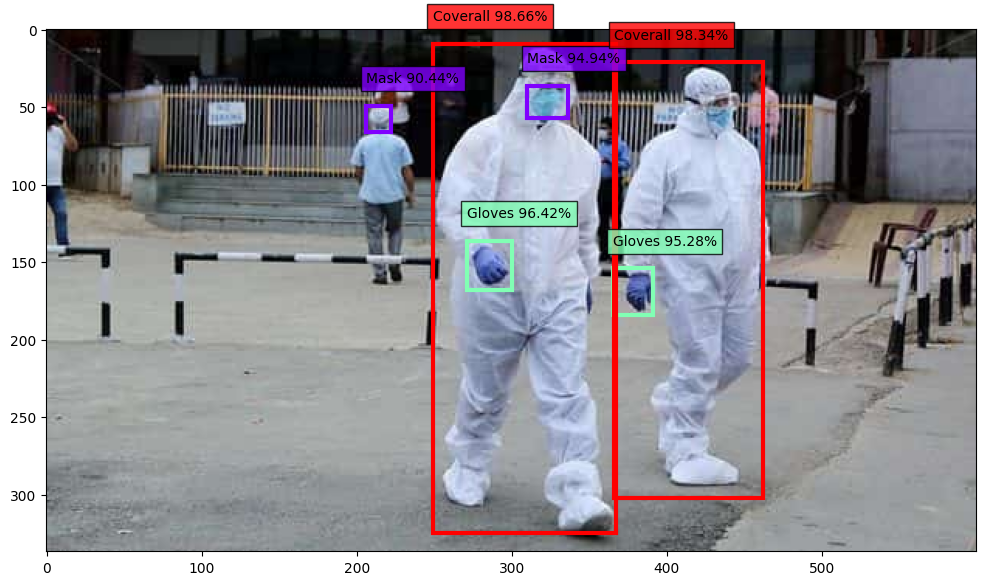

Counter({'Mask': 1})


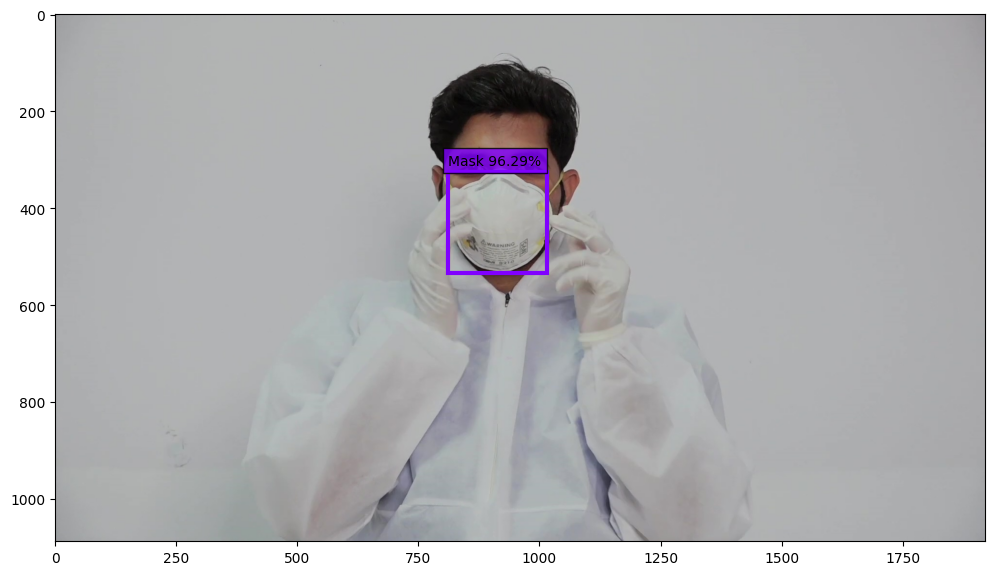

In [103]:
for linha in dados.select(range(50, 55)):
    imagem = linha['image']
    deteccao = detector(imagem)

    contador = Counter(det['label'] for det in deteccao)
    print(contador)

    plotar_deteccao(imagem=imagem, deteccao=deteccao, colormap='rainbow')
    plt.show()

O modelo parece bom, mas não é perfeito!